# Electrophysiology 101

Neuronal electrophysiology (ephys) refers to the study of the electrical properties of cells and tissue in the nervous system. Ephys is one of the <em>most prevalent</em> types of studies in the field of Neuroscience and its benefits cannot be overstated. One type of ephys experiment is called extracellular electrophysiology which involves inserting a probe into the tissue of interest and studying the surrounding electrical activity in the presence of a stimulus.
    
While there are many ways to conduct an ephys experiment and structure its processing and analysis, the scope of the workflow described below refers to the approach DataJoint has taken as a result of extensive collaboration with neuroscience laboratories around the world.
    
### General Structure
   
1. The electrode arrays (probes) are inserted into the brain-area of interest. 
2. The user decides which area of the probe will be used (i.e a subset of the total number of electrodes.).
3. The researcher conducts the experiment, usually presenting some stimuli to the subject. 
4. The raw data is collected and clustered.
5. The data is further divided into the units, spike times, and waveforms.

    
More on Clustering:
The clustering analysis processes raw data and retrieves units, spiketimes, and waveforms.










<hr>

# Introduction to the workflow structure

This objective of notebook is to give a brief overview of the workflow structure and introduce some useful DataJoint tools to facilitate the exploration.
+ DataJoint needs to be pre-configured before running this notebook, if you haven't set up the configuration, refer to notebook [01-configure](01-configure.ipynb).
+ If you are familar with DataJoint and the workflow structure, proceed to the next notebook [03-process](03-process.ipynb) directly to run the workflow.
+ For a more thorough introduction of DataJoint functionings, please visit our [general tutorial site](https://playground.datajoint.io)

To load the local configuration, we will change the directory to the package root.

In [2]:
import os
os.chdir('..')

## Schemas and tables

The current workflow is composed of multiple database schemas, each of them corresponds to a module within `workflow_array_ephys.pipeline`

In [20]:
import datajoint as dj
from workflow_array_ephys.pipeline import lab, subject, session, probe, ephys

In [21]:
probe.schema

Schema `neuro_probe`

In [22]:
ephys.schema

Schema `neuro_ephys`

In [6]:
# preview table columns and contents in a table
ephys.EphysRecording()

subject,session_datetime,insertion_number,electrode_config_hash,acq_software,sampling_rate (Hz)
subject6,2021-01-15 11:16:38,0,6f6d8149-1603-9d2c-f884-0fdf995ec8b3,SpikeGLX,30000.6
subject7,2021-01-15 11:16:38,0,6f6d8149-1603-9d2c-f884-0fdf995ec8b3,SpikeGLX,30000.6


 + By importing the modules for the first time, the schemas and tables will be created inside the database.
 + Once created, importing modules will not create schemas and tables again, but the existing schemas/tables can be accessed and manipulated by the modules.

## DataJoint tools to explore schemas and tables

 + `dj.list_schemas()`: list all schemas a user has access to in the current database

In [7]:
dj.list_schemas()

['neuro_ephys',
 'neuro_probe',
 'neuro_subject',
 'lab',
 'subject',
 'mysql',
 'performance_schema',
 'neuro_lab',
 'ephys',
 'neuro_session',
 'probe',
 'session']

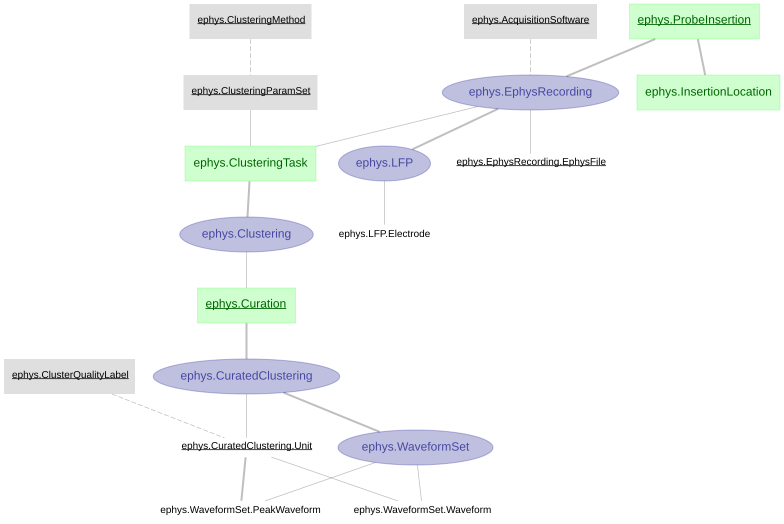

In [8]:
# plot diagram for all tables in a schema
dj.Diagram(ephys)

**Table tiers**: 

Manual table: green box, manually inserted table, expect new entries daily, e.g. Subject, ProbeInsertion.  
Lookup table: gray box, pre inserted table, commonly used for general facts or parameters. e.g. Strain, ClusteringMethod, ClusteringParamSet.  
Imported table: blue oval, auto-processing table, the processing depends on the importing of external files. e.g. process of Clustering requires output files from kilosort2.  
Computed table: red circle, auto-processing table, the processing does not depend on files external to the database, commonly used for     
Part table: plain text, as an appendix to the master table, all the part entries of a given master entry represent a intact set of the master entry. e.g. Unit of a CuratedClustering.

**Dependencies**:  

One-to-one primary: thick solid line, share the exact same primary key, meaning the child table inherits all the primary key fields from the parent table as its own primary key.     
One-to-many primary: thin solid line, inherit the primary key from the parent table, but have additional field(s) as part of the primary key as well
secondary dependency: dashed line, the child table inherits the primary key fields from parent table as its own secondary attribute.

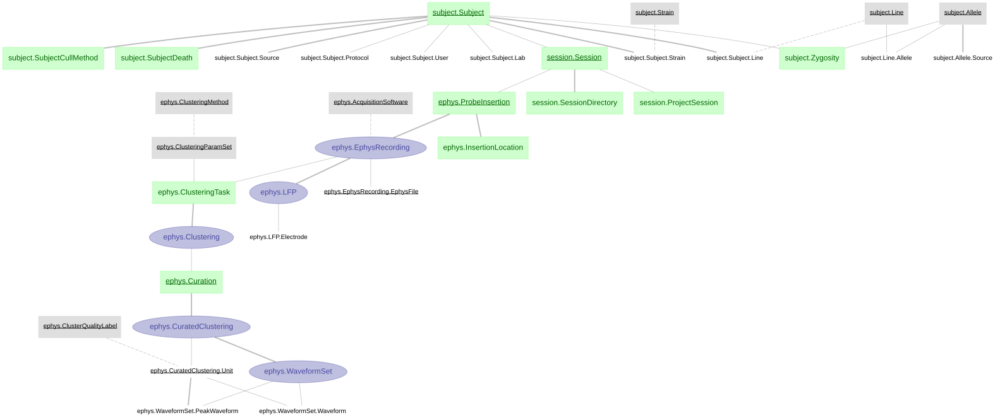

In [9]:
# plot diagram of tables in multiple schemas
dj.Diagram(subject) + dj.Diagram(session) + dj.Diagram(ephys)

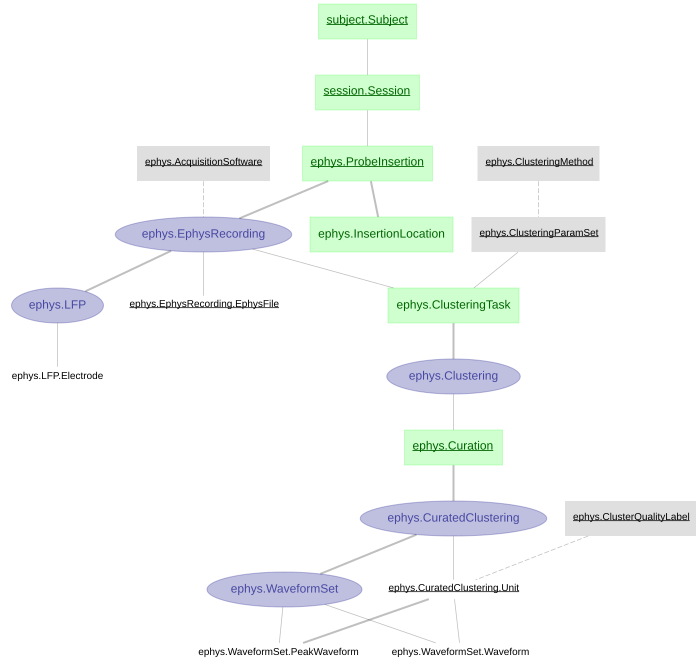

In [10]:
# plot diagram of selected tables and schemas
dj.Diagram(subject.Subject) + dj.Diagram(session.Session) + dj.Diagram(ephys)

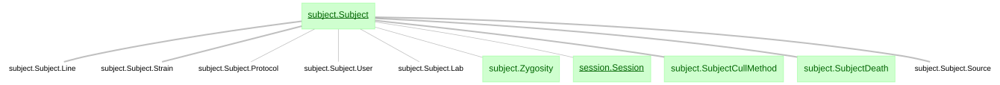

In [11]:
# plot diagram with 1 additional level of dependency downstream
dj.Diagram(subject.Subject) + 1

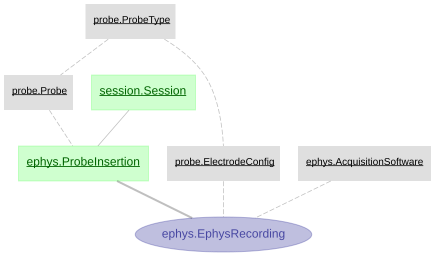

In [12]:
# plot diagram with 2 additional levels of dependency upstream
dj.Diagram(ephys.EphysRecording) - 2

 + `describe()`: show table definition with foreign key references.

In [13]:
ephys.EphysRecording.describe();

# Ephys recording from a probe insertion for a given session.
-> ephys.ProbeInsertion
---
-> probe.ElectrodeConfig
-> ephys.AcquisitionSoftware
sampling_rate        : float                        # (Hz)



In [13]:
ephys.EphysRecording.heading

# Ephys recording from a probe insertion for a given session.
subject              : varchar(32)                  # 
session_datetime     : datetime(3)                  # 
insertion_number     : tinyint unsigned             # 
---
electrode_config_hash : uuid                         # 
acq_software         : varchar(24)                  # 
sampling_rate        : float                        # (Hz)

# Major DataJoint Elements installed in the current workflow

+ [`lab`](https://github.com/datajoint/element-lab): lab management related information, such as Lab, User, Project, Protocol, Source.

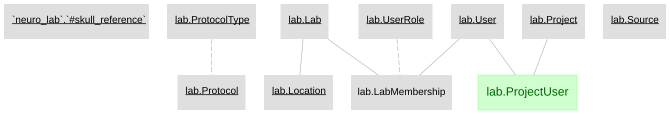

In [17]:
dj.Diagram(lab)

+ `probe`: probe related information, such as Probe used, Probe type,and  Electrode configuration.

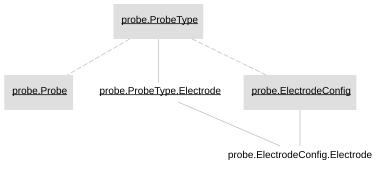

In [8]:
dj.Diagram(probe)

In [ ]:
![Array%20Electropshyiology-probe%20info%20%283%29.svg](attachment:Array%20Electropshyiology-probe%20info%20%283%29.svg)

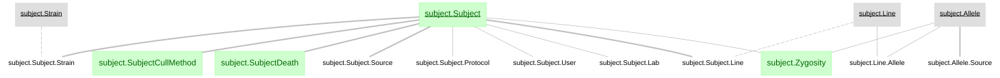

In [14]:
dj.Diagram(subject) 

# ![subject_Array%20Electropshyiology-Subject.svg](attachment:subject_Array%20Electropshyiology-Subject.svg)

In [16]:
subject.Subject.describe();

# Animal Subject
subject              : varchar(32)                  
---
sex                  : enum('M','F','U')            
subject_birth_date   : date                         
subject_description="" : varchar(1024)                



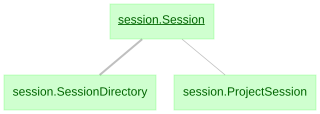

In [24]:

dj.Diagram(session)

In [25]:
session.Session.describe();

-> subject.Subject
session_datetime     : datetime(3)                  



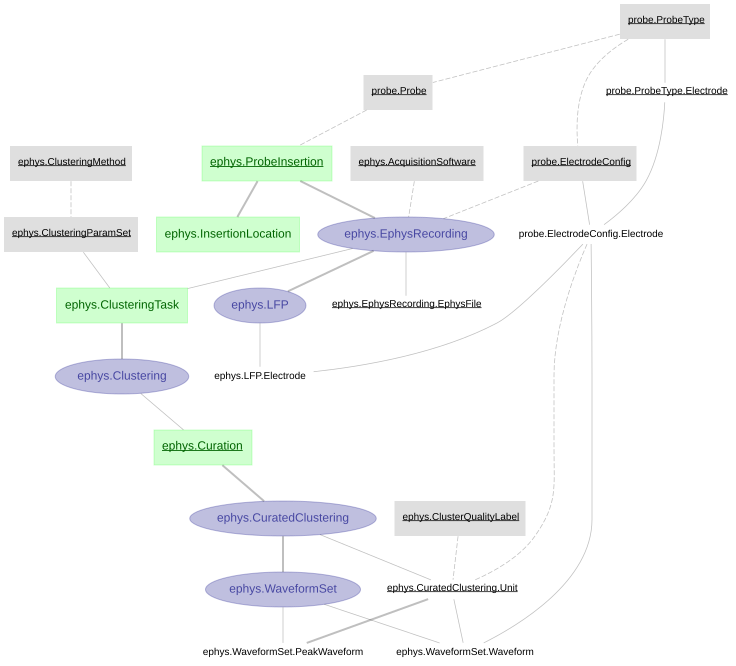

In [26]:
dj.Diagram(probe) + dj.Diagram(ephys)

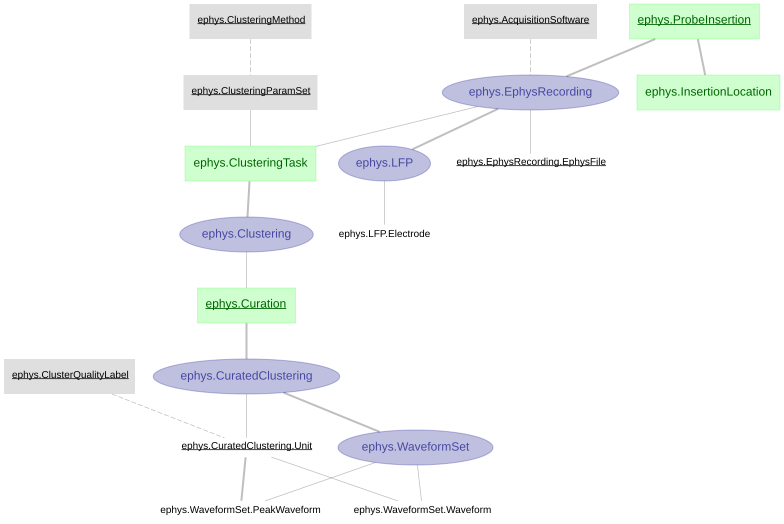

In [28]:
dj.Diagram(ephys)

<hr>

## DataJoint Questions
1. What is the difference between the `.heading` attribute and the `.describe()` method?
2. The `ephys.EphysRecording` table is shown in the Diagram inside a blue bubble, while `ephys.ProbeInsertion` is shown in a green box. What do the color differences tell us about these tables? 
3. We see in the `ephys.LFP.Electrode` table that the primary keys are inherited from the `ephys.LFP` table and the `probe.ElectrodeConfig.Electrode` table. What does this tell us about the way inheritance can work across schemas? 
4. What does `ephys.EphysRecording` being connected to `ephys.LFP` by a thick, solid tell me? 
5. What method can I use to see a list of all the schemas in my database?

## Workflow Questions
1. Which table tells us the probe and electrode a unit is coming from? (Hint: You can hover over the tables diagram to see their fields.)
2. If I was at the examining the data at the `ephys.EphysRecording` table, and I wanted more data regarding the subject regarding the subject's zygosity, what schema and table could I use to find that information? (Hint: You can trace the pipeline, explore different schemas to find this answer).
3. The tables `ephys.ClusteringTask` and `ephys.Curation` both have a field pointing Datajoint to an output directory. Under what conditions would these fields be the same? Under what conditions would these fields be different?
4. What is the difference between `ephys.WaveformSet.PeakWaveform` and `ephys.WaveformSet.Waveform`?(Hint: look at the fields in both.)


## Summary and next step

+ This notebook introduced the overall structures of the schemas and tables in the workflow and relevant tools to explore the schema structure and table definitions.

+ In the next notebook [03-process](03-process.ipynb), we will further introduce the detailed steps running through the pipeline and table contents accordingly.